In [1]:
import warnings
warnings.filterwarnings("ignore")

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from matplotlib.lines import Line2D
from matplotlib import colors as mcolors

import scanpy as sc
import squidpy as sq
import cellcharter as cc
import scvi

from pandas.api.types import is_numeric_dtype, is_categorical_dtype
from scipy.sparse import issparse


# ------------------------------------------------------------------
# 1) Define and apply course + region + sample_id order
# ------------------------------------------------------------------
course_order = [
    "MOG CFA",
    "early onset",
    "chronic peak",
    "chronic long",

    "PLP CFA",
    "non symptomatic",
    "monophasic",

    "onset I",
    "onset II",
    "peak I",
    "remitt I",
    "peak II",
    "remitt II",
    "peak III",
]

region_order = ["L", "T", "C"]


def apply_course_region_and_sample_order(ad, sample_key="sample_id"):
    """Make ad.obs['course'], ad.obs['region'], and ad.obs[sample_key] ordered categoricals."""
    # --- course ---
    if "course" in ad.obs.columns:
        ad.obs["course"] = ad.obs["course"].astype(
            pd.CategoricalDtype(categories=course_order, ordered=True)
        )

    # --- region ---
    if "region" in ad.obs.columns:
        ad.obs["region"] = ad.obs["region"].astype(
            pd.CategoricalDtype(categories=region_order, ordered=True)
        )

    # --- sample_id ordered by (course, region, sample_id) ---
    if (
        sample_key in ad.obs.columns
        and "course" in ad.obs.columns
        and "region" in ad.obs.columns
    ):
        tmp = (
            ad.obs[[sample_key, "course", "region"]]
            .drop_duplicates()
            .dropna(subset=["course", "region"])
            .copy()
        )

        tmp["course"] = tmp["course"].astype(
            pd.CategoricalDtype(categories=course_order, ordered=True)
        )
        tmp["region"] = tmp["region"].astype(
            pd.CategoricalDtype(categories=region_order, ordered=True)
        )

        tmp = tmp.sort_values(["course", "region", sample_key])
        sample_order = tmp[sample_key].tolist()

        ad.obs[sample_key] = ad.obs[sample_key].astype(
            pd.CategoricalDtype(categories=sample_order, ordered=True)
        )

        ad.uns[f"{sample_key}_order_by_course_region"] = sample_order

    return ad


# ------------------------------------------------------------------
# 2) Plot function (obs + genes, ordered groupby, shared vmin/vmax)
# ------------------------------------------------------------------
def plot_spatial_compact_fast(
    ad,
    color="leiden_2",       # obs column *or* gene name
    groupby="sample_id",
    spot_size=8,
    cols=3,
    height=8,
    legend_col_width=1.2,
    palette=None,
    rasterized=True,
    invert_y=True,
    dpi=120,
    highlight=None,
    group_order=None,
    background="white",
    grey_alpha=0.2,         # alpha for non-highlighted categories
    vmin=None,
    vmax=None,
    cmap_name="viridis",
    shared_scale=False,     # if True: vmin/vmax from whole `ad` (not per subset)
):
    # pick background + text color
    fig_face = background
    ax_face = background
    text_color = "white" if background in ("black", "#000000", "k") else "black"

    # ----- 0) Preconditions -----
    if "spatial" not in ad.obsm:
        raise ValueError("ad.obsm['spatial'] not found")

    if groupby not in ad.obs.columns:
        raise KeyError(f"groupby {groupby!r} not in ad.obs")

    # decide where 'color' comes from: obs vs var (gene)
    if color in ad.obs.columns:
        color_source = "obs"
        col_series = ad.obs[color]
    elif color in ad.var_names:
        color_source = "var"   # gene expression
        col_series = None
    else:
        raise KeyError(
            f"{color!r} not found in ad.obs.columns or ad.var_names "
            "(expected an obs column or a gene name)."
        )

    coords = np.asarray(ad.obsm["spatial"])[:, :2]

    # Detect continuous vs categorical
    if color_source == "var":
        # genes: always continuous
        is_continuous = True
    else:
        if is_categorical_dtype(col_series):
            is_continuous = False
        else:
            is_continuous = is_numeric_dtype(col_series)

    # ----------------------------------------------------
    # 1) Build colors_arr differently for cont vs cat
    # ----------------------------------------------------
    if is_continuous:
        # ===== CONTINUOUS MODE =====
        if color_source == "obs":
            vals = col_series.to_numpy(dtype=float)
        else:
            # from var / gene expression
            gene_idx = ad.var_names.get_loc(color)
            x = ad.X[:, gene_idx]
            if issparse(x):
                vals = x.toarray().ravel()
            else:
                vals = np.asarray(x).ravel()

        # choose colormap
        if palette is None:
            cmap = plt.get_cmap(cmap_name)
        elif isinstance(palette, str):
            cmap = plt.get_cmap(palette)
        else:
            cmap = palette

        # ----- determine vmin/vmax -----
        if shared_scale:
            # global min/max across the *full AnnData* passed to this function
            full = ad
            if color_source == "var":
                gx = full.X[:, full.var_names.get_loc(color)]
                if issparse(gx):
                    full_vals = gx.toarray().ravel()
                else:
                    full_vals = np.asarray(gx).ravel()
            else:
                full_vals = pd.to_numeric(full.obs[color], errors="coerce").to_numpy()

            finite_full = np.isfinite(full_vals)
            if finite_full.sum() == 0:
                raise ValueError(f"All values for '{color}' are NaN or non-finite.")
            vmin_use = float(np.min(full_vals[finite_full]))
            vmax_use = float(np.max(full_vals[finite_full]))
        else:
            finite_mask = np.isfinite(vals)
            if finite_mask.sum() == 0:
                raise ValueError(f"All values for '{color}' are NaN or non-finite.")
            vmin_use = float(np.min(vals[finite_mask]))
            vmax_use = float(np.max(vals[finite_mask]))

        # user overrides everything
        if vmin is not None:
            vmin_use = float(vmin)
        if vmax is not None:
            vmax_use = float(vmax)

        # avoid zero-range
        if vmin_use == vmax_use:
            vmin_use -= 1.0
            vmax_use += 1.0

        norm = mcolors.Normalize(vmin=vmin_use, vmax=vmax_use)

        colors_arr = np.zeros((vals.size, 4), dtype=float)
        finite_mask = np.isfinite(vals)
        colors_arr[finite_mask] = cmap(norm(vals[finite_mask]))
        colors_arr[~finite_mask] = (0, 0, 0, 0)

        # store continuous settings in uns (also fine for genes)
        ad.uns[f"{color}_continuous"] = {
            "vmin": float(vmin_use),
            "vmax": float(vmax_use),
            "cmap": cmap.name if hasattr(cmap, "name") else str(cmap),
        }

        cat_names = None
        cat_codes = None

    else:
        # ===== CATEGORICAL (only for obs) =====
        # preserve existing categorical order if present
        if is_categorical_dtype(col_series):
            cats = col_series.cat.remove_unused_categories()
        else:
            cats = col_series.astype("category")

        cat_names = cats.cat.categories
        cat_codes = cats.cat.codes.to_numpy()

        # palette handling
        if isinstance(palette, dict):
            col_list = [palette[c] for c in cat_names]
        elif isinstance(palette, (list, tuple)):
            if len(palette) < len(cat_names):
                raise ValueError("Palette shorter than number of categories.")
            col_list = list(palette)[:len(cat_names)]
        elif f"{color}_colors" in ad.uns:
            col_list = list(ad.uns[f"{color}_colors"])
            if len(col_list) != len(cat_names):
                raise ValueError(f"{color}_colors length != categories.")
        else:
            base = list(
                sc.pl.palettes.default_64
                if hasattr(sc.pl.palettes, "default_64")
                else sc.pl.palettes.default_102
            )
            reps = int(np.ceil(len(cat_names) / len(base)))
            col_list = (base * reps)[:len(cat_names)]

        ad.uns[f"{color}_colors"] = col_list

        rgba = np.array([mcolors.to_rgba(c) for c in col_list], dtype=float)

        colors_arr = np.empty((cat_codes.size, 4), dtype=float)
        colors_arr[cat_codes >= 0] = rgba[cat_codes[cat_codes >= 0]]
        colors_arr[cat_codes < 0] = (0, 0, 0, 0)

        # ----- highlighting logic -----
        if highlight is not None:
            # allow single value or list/tuple/array
            if not isinstance(highlight, (list, tuple, set, np.ndarray)):
                highlight = [highlight]
            # convert to string for robust matching
            highlight_str = {str(h) for h in highlight}

            cat_name_str = np.array([str(c) for c in cat_names])
            keep_cat_mask = np.isin(cat_name_str, list(highlight_str))  # per-category

            # use user-defined alpha for greyed-out categories
            grey_rgba = (0.8, 0.8, 0.8, float(grey_alpha))

            valid = cat_codes >= 0
            keep_flag = np.zeros_like(cat_codes, dtype=bool)
            keep_flag[valid] = keep_cat_mask[cat_codes[valid]]

            # grey out all non-highlighted cells
            colors_arr[valid & ~keep_flag] = grey_rgba

            # also grey in legend
            col_list = [
                col_list[k] if keep_cat_mask[k] else mcolors.to_hex(grey_rgba)
                for k in range(len(cat_names))
            ]

    # ----------------------------------------------------
    # 2) Precompute group indices (RESPECT ORDERED CATEGORICAL)
    # ----------------------------------------------------
    gser = ad.obs[groupby]

    if group_order is not None:
        group_order = [str(g) for g in group_order]
        present = set(gser.astype(str))
        uniq_groups = [g for g in group_order if g in present]
    else:
        # if groupby is an ordered categorical, respect its category order
        if is_categorical_dtype(gser) and gser.cat.ordered:
            cats = list(gser.cat.categories)
            present = set(gser.astype(str))
            uniq_groups = [str(c) for c in cats if str(c) in present]
        else:
            # fallback: sorted unique strings
            uniq_groups = sorted(gser.astype(str).unique())

    gvals = gser.astype(str).to_numpy()
    gid_to_idx = {g: i for i, g in enumerate(uniq_groups)}
    gcodes = np.array([gid_to_idx.get(g, -1) for g in gvals], dtype=int)

    group_indices = [np.flatnonzero(gcodes == gi) for gi in range(len(uniq_groups))]

    # ----------------------------------------------------
    # 3) Figure layout
    # ----------------------------------------------------
    n = len(uniq_groups)
    rows = int(np.ceil(n / cols))
    panel_w = height * cols * 0.6 / rows
    fig_w = panel_w + legend_col_width

    plt.ioff()
    fig = plt.figure(figsize=(fig_w, height), dpi=dpi, constrained_layout=False)

    # background for figure
    fig.patch.set_facecolor(fig_face)

    gs = GridSpec(
        rows, cols + 1, figure=fig,
        width_ratios=[1]*cols + [legend_col_width / (fig_w - legend_col_width)],
        wspace=0.02, hspace=0.02
    )

    # ----------------------------------------------------
    # 4) Panels
    # ----------------------------------------------------
    for i, sid in enumerate(uniq_groups):
        r, c = divmod(i, cols)
        ax = fig.add_subplot(gs[r, c])

        # panel background
        ax.set_facecolor(ax_face)

        idx = group_indices[i]
        if idx.size:
            xy = coords[idx]
            ax.scatter(
                xy[:, 0], -xy[:, 1],
                c=colors_arr[idx],
                s=spot_size,
                marker='o',
                linewidths=0,
                rasterized=rasterized
            )

        meta_strings = []

        if "region" in ad.obs.columns:
            region_vals = (
                ad.obs.loc[ad.obs[groupby] == sid, "region"]
                .dropna().astype(str).unique()
            )
            if len(region_vals) == 0:
                meta_strings.append("Region: unknown")
            elif len(region_vals) == 1:
                meta_strings.append(f"Region: {region_vals[0]}")
            else:
                meta_strings.append("Region: mixed")

        if "course" in ad.obs.columns:
            course_vals = (
                ad.obs.loc[ad.obs[groupby] == sid, "course"]
                .dropna().astype(str).unique()
            )
            if len(course_vals) == 0:
                meta_strings.append("Course: unknown")
            elif len(course_vals) == 1:
                meta_strings.append(f"Course: {course_vals[0]}")
            else:
                meta_strings.append("Course: mixed")

        if meta_strings:
            title = f"{sid}\n[{ ' | '.join(meta_strings) }]"
        else:
            title = str(sid)

        ax.set_title(title, fontsize=5, pad=2, color=text_color)
        ax.set_aspect("equal")
        if invert_y:
            ax.invert_yaxis()
        ax.set_axis_off()

    # blank unused panels
    for j in range(n, rows * cols):
        r, c = divmod(j, cols)
        ax = fig.add_subplot(gs[r, c])
        ax.set_facecolor(ax_face)
        ax.axis("off")

    # ----------------------------------------------------
    # 5) Legend / Colorbar
    # ----------------------------------------------------
    ax_leg = fig.add_subplot(gs[:, -1])
    ax_leg.set_facecolor(ax_face)
    ax_leg.axis("off")

    if is_continuous:
        sm = plt.cm.ScalarMappable(norm=norm, cmap=cmap)
        sm.set_array([])
        cbar = fig.colorbar(sm, cax=ax_leg)
        cbar.set_label(color, rotation=90, color=text_color)
        cbar.ax.yaxis.set_tick_params(color=text_color)
        plt.setp(plt.getp(cbar.ax.axes, "yticklabels"), color=text_color)
    else:
        handles = [
            Line2D(
                [0], [0], marker="o", color="w",
                markerfacecolor=col_list[k], markersize=7, label=str(cat)
            )
            for k, cat in enumerate(cat_names)
        ]
        leg = ax_leg.legend(
            handles=handles,
            title=color,
            frameon=False,
            loc="center left",
            labelcolor=text_color,
            title_fontsize=10
        )
        leg.get_title().set_color(text_color)
        for text in leg.get_texts():
            text.set_color(text_color)

    fig.subplots_adjust(
        left=0.01, right=0.98, top=0.98, bottom=0.02,
        wspace=0.02, hspace=0.02
    )

    plt.ion()
    plt.show()


In [2]:
import scanpy as sc
import sys
print(sys.version)
print(sys.executable)

3.12.12 | packaged by conda-forge | (main, Oct 22 2025, 23:34:53) [Clang 19.1.7 ]
/Users/christoffer/miniconda3/envs/cellcharter-env/bin/python


In [3]:
"""
Weighted neighbor aggregation for CellCharter.

This module extends CellCharter's aggregate_neighbors function to support:
1. Hop-level decay: First hop contributes more than second, second more than third, etc.
2. Within-hop distance weighting: Closer cells within each hop contribute more.

Author: Christoffer (with Claude)
"""

import numpy as np
from scipy.sparse import csr_matrix, issparse, diags
from scipy.spatial.distance import cdist
from anndata import AnnData
from typing import Union, Literal, Optional, List
import warnings


def compute_hop_matrices(
    connectivity: csr_matrix,
    n_layers: int,
) -> List[csr_matrix]:
    """
    Compute sparse matrices indicating neighbors at exactly each hop distance.
    
    Parameters
    ----------
    connectivity : csr_matrix
        Binary connectivity matrix (1 = neighbors, 0 = not neighbors)
    n_layers : int
        Number of hops to compute
        
    Returns
    -------
    List of sparse matrices, one per hop (index 0 = hop 1, index 1 = hop 2, etc.)
    Each matrix has 1s for cells at exactly that hop distance.
    """
    n_cells = connectivity.shape[0]
    
    # Track which cells have been "reached" at previous hops
    # Start with self (hop 0)
    reached = csr_matrix(np.eye(n_cells))
    
    hop_matrices = []
    current_neighbors = connectivity.copy()
    
    for hop in range(1, n_layers + 1):
        if hop == 1:
            # First hop is just direct neighbors
            hop_matrix = connectivity.copy()
        else:
            # Multiply to get cells reachable in `hop` steps
            current_neighbors = current_neighbors @ connectivity
            # Binarize (we just care about reachability)
            current_neighbors.data = np.ones_like(current_neighbors.data)
            # Subtract already-reached cells to get ONLY cells at exactly this hop
            hop_matrix = current_neighbors - reached
            # Remove negative values (cells already reached)
            hop_matrix.data = np.maximum(hop_matrix.data, 0)
            hop_matrix.eliminate_zeros()
        
        hop_matrices.append(hop_matrix.copy())
        
        # Update reached to include this hop
        reached = reached + hop_matrix
        reached.data = np.minimum(reached.data, 1)  # Binarize
    
    return hop_matrices


def compute_distance_weights(
    coords: np.ndarray,
    hop_matrix: csr_matrix,
    kernel: Literal['exponential', 'inverse', 'gaussian', 'none'] = 'exponential',
    scale: Optional[float] = None,
    epsilon: float = 1e-6,
) -> csr_matrix:
    """
    Compute distance-based weights for neighbors in a hop matrix.
    
    Parameters
    ----------
    coords : np.ndarray
        Spatial coordinates, shape (n_cells, n_dims)
    hop_matrix : csr_matrix
        Sparse matrix indicating neighbors at this hop
    kernel : str
        Distance weighting kernel:
        - 'exponential': exp(-d / scale)
        - 'inverse': 1 / (d + epsilon)
        - 'gaussian': exp(-d^2 / (2 * scale^2))
        - 'none': uniform weights (1.0 for all neighbors)
    scale : float, optional
        Scale parameter for kernels. If None, auto-computed as median distance.
    epsilon : float
        Small value to prevent division by zero for 'inverse' kernel
        
    Returns
    -------
    Sparse matrix with distance-based weights
    """
    if kernel == 'none':
        return hop_matrix.astype(float)
    
    # Get the indices of non-zero entries (i.e., neighbor pairs)
    rows, cols = hop_matrix.nonzero()
    
    if len(rows) == 0:
        return hop_matrix.astype(float)
    
    # Compute pairwise distances for neighbor pairs only
    distances = np.sqrt(np.sum((coords[rows] - coords[cols]) ** 2, axis=1))
    
    # Auto-compute scale if not provided
    if scale is None:
        scale = np.median(distances) if len(distances) > 0 else 1.0
        if scale == 0:
            scale = 1.0
    
    # Apply kernel
    if kernel == 'exponential':
        weights = np.exp(-distances / scale)
    elif kernel == 'inverse':
        weights = 1.0 / (distances + epsilon)
    elif kernel == 'gaussian':
        weights = np.exp(-distances ** 2 / (2 * scale ** 2))
    else:
        raise ValueError(f"Unknown kernel: {kernel}")
    
    # Create weighted sparse matrix
    weighted_matrix = csr_matrix(
        (weights, (rows, cols)),
        shape=hop_matrix.shape
    )
    
    return weighted_matrix


def aggregate_neighbors_weighted(
    adata: AnnData,
    n_layers: int = 3,
    aggregations: Union[str, List[str]] = 'mean',
    connectivity_key: Optional[str] = None,
    use_rep: Optional[str] = None,
    sample_key: Optional[str] = None,
    out_key: str = 'X_cellcharter_weighted',
    copy: bool = False,
    # New parameters for weighting
    hop_decay: Union[float, Literal['learn'], List[float]] = 0.5,
    distance_kernel: Literal['exponential', 'inverse', 'gaussian', 'none'] = 'exponential',
    distance_scale: Optional[float] = None,
    spatial_key: str = 'spatial',
    normalize_weights: bool = True,
    include_self: bool = True,
) -> Optional[AnnData]:
    """
    Aggregate neighbor features with hop-level decay and distance-based weighting.
    
    This extends CellCharter's aggregate_neighbors to weight neighbors by:
    1. Hop distance: neighbors at hop h are weighted by hop_decay^h
    2. Spatial distance: within each hop, closer cells contribute more
    
    Parameters
    ----------
    adata : AnnData
        Annotated data object
    n_layers : int
        Number of hops to aggregate
    aggregations : str or list
        Aggregation function(s): 'mean', 'sum', 'var', 'std'
        Note: with weighting, 'mean' becomes weighted mean
    connectivity_key : str, optional
        Key in adata.obsp for connectivity matrix. 
        If None, uses 'spatial_connectivities'
    use_rep : str, optional
        Key in adata.obsm for feature representation.
        If None, uses adata.X
    sample_key : str, optional
        Key in adata.obs for sample/batch information.
        If provided, aggregation is done within samples.
    out_key : str
        Key to store output in adata.obsm
    copy : bool
        Return a copy instead of modifying in place
        
    hop_decay : float or list
        Decay factor for hop weighting:
        - float: weight for hop h = hop_decay^h (e.g., 0.5 -> 0.5, 0.25, 0.125)
        - list: explicit weights for each hop [w1, w2, w3, ...]
    distance_kernel : str
        Kernel for distance weighting within hops:
        - 'exponential': exp(-d / scale) [recommended]
        - 'inverse': 1 / (d + epsilon)
        - 'gaussian': exp(-d^2 / (2 * scale^2))
        - 'none': no distance weighting (original CellCharter behavior)
    distance_scale : float, optional
        Scale parameter for distance kernel. If None, auto-computed as
        median neighbor distance per hop.
    spatial_key : str
        Key in adata.obsm for spatial coordinates
    normalize_weights : bool
        If True, normalize weights to sum to 1 per cell per hop
    include_self : bool
        If True, include cell's own features (hop 0) in output
        
    Returns
    -------
    If copy=True, returns modified AnnData. Otherwise modifies in place.
    
    Examples
    --------
    >>> import scanpy as sc
    >>> import squidpy as sq
    >>> import cellcharter as cc
    >>> 
    >>> # Build spatial graph
    >>> sq.gr.spatial_neighbors(adata, coord_type='generic', delaunay=True)
    >>> cc.gr.remove_long_links(adata)
    >>> 
    >>> # Standard aggregation (original CellCharter)
    >>> cc.gr.aggregate_neighbors(adata, n_layers=3, use_rep='X_scVI')
    >>> 
    >>> # Weighted aggregation (this function)
    >>> aggregate_neighbors_weighted(
    ...     adata, 
    ...     n_layers=3, 
    ...     use_rep='X_scVI',
    ...     hop_decay=0.5,  # Each hop contributes half as much
    ...     distance_kernel='exponential',
    ... )
    """
    adata = adata.copy() if copy else adata
    
    # Get connectivity matrix
    if connectivity_key is None:
        connectivity_key = 'spatial_connectivities'
    
    if connectivity_key not in adata.obsp:
        raise KeyError(
            f"Connectivity matrix '{connectivity_key}' not found. "
            "Run sq.gr.spatial_neighbors() first."
        )
    
    connectivity = adata.obsp[connectivity_key]
    if not issparse(connectivity):
        connectivity = csr_matrix(connectivity)
    
    # Binarize connectivity (in case it has weights)
    connectivity_binary = connectivity.copy()
    connectivity_binary.data = np.ones_like(connectivity_binary.data)
    
    # Get features
    if use_rep is None:
        features = adata.X
        if issparse(features):
            features = features.toarray()
    else:
        if use_rep not in adata.obsm:
            raise KeyError(f"Representation '{use_rep}' not found in adata.obsm")
        features = adata.obsm[use_rep]
    
    features = np.asarray(features)
    n_cells, n_features = features.shape
    
    # Get spatial coordinates
    if spatial_key not in adata.obsm:
        raise KeyError(
            f"Spatial coordinates '{spatial_key}' not found. "
            "Make sure spatial coordinates are in adata.obsm."
        )
    coords = np.asarray(adata.obsm[spatial_key])
    
    # Parse hop decay weights
    if isinstance(hop_decay, (int, float)):
        hop_weights = [hop_decay ** h for h in range(1, n_layers + 1)]
    elif isinstance(hop_decay, list):
        if len(hop_decay) != n_layers:
            raise ValueError(
                f"hop_decay list length ({len(hop_decay)}) must match n_layers ({n_layers})"
            )
        hop_weights = hop_decay
    else:
        raise ValueError(f"hop_decay must be float or list, got {type(hop_decay)}")
    
    # Parse aggregations
    if isinstance(aggregations, str):
        aggregations = [aggregations]
    
    # Compute hop matrices (which cells are at exactly hop h)
    hop_matrices = compute_hop_matrices(connectivity_binary, n_layers)
    
    # Handle sample-wise processing
    if sample_key is not None and sample_key in adata.obs:
        samples = adata.obs[sample_key].unique()
        sample_indices = {s: np.where(adata.obs[sample_key] == s)[0] for s in samples}
    else:
        sample_indices = {'all': np.arange(n_cells)}
    
    # Collect aggregated features
    all_aggregated = []
    
    # Include self features (hop 0)
    if include_self:
        all_aggregated.append(features)
    
    # Process each hop
    for hop_idx, (hop_matrix, hop_weight) in enumerate(zip(hop_matrices, hop_weights)):
        hop = hop_idx + 1
        
        # Initialize aggregated features for this hop
        hop_aggregated = {agg: np.zeros((n_cells, n_features)) for agg in aggregations}
        
        # Process each sample separately if sample_key provided
        for sample_name, indices in sample_indices.items():
            if len(indices) == 0:
                continue
            
            # Get submatrices for this sample
            if sample_key is not None:
                sample_hop_matrix = hop_matrix[np.ix_(indices, indices)]
                sample_coords = coords[indices]
                sample_features = features[indices]
            else:
                sample_hop_matrix = hop_matrix
                sample_coords = coords
                sample_features = features
            
            # Compute distance weights for this hop
            weighted_matrix = compute_distance_weights(
                sample_coords,
                sample_hop_matrix,
                kernel=distance_kernel,
                scale=distance_scale,
            )
            
            # Apply hop-level decay
            weighted_matrix = weighted_matrix * hop_weight
            
            # Normalize weights if requested
            if normalize_weights:
                row_sums = np.array(weighted_matrix.sum(axis=1)).flatten()
                row_sums[row_sums == 0] = 1  # Prevent division by zero
                normalizer = diags(1.0 / row_sums)
                weighted_matrix = normalizer @ weighted_matrix
            
            # Compute aggregations
            for agg in aggregations:
                if agg == 'mean':
                    # Weighted mean
                    agg_features = weighted_matrix @ sample_features
                elif agg == 'sum':
                    # Weighted sum (don't normalize)
                    if normalize_weights:
                        # Undo normalization for sum
                        row_sums = np.array(hop_matrix[np.ix_(indices, indices)].sum(axis=1)).flatten()
                        row_sums[row_sums == 0] = 1
                        agg_features = (weighted_matrix @ sample_features) * row_sums[:, None]
                    else:
                        agg_features = weighted_matrix @ sample_features
                elif agg in ['var', 'std']:
                    # Weighted variance: sum(w * (x - weighted_mean)^2) / sum(w)
                    weighted_mean = weighted_matrix @ sample_features
                    # Compute squared deviations weighted
                    # This is trickier with sparse matrices...
                    # For simplicity, we'll compute unweighted variance for now
                    warnings.warn(
                        f"Weighted {agg} uses approximate computation. "
                        "Consider using 'mean' for weighted aggregation."
                    )
                    # Fall back to unweighted
                    neighbor_counts = np.array(sample_hop_matrix.sum(axis=1)).flatten()
                    neighbor_counts[neighbor_counts == 0] = 1
                    
                    sum_sq = sample_hop_matrix @ (sample_features ** 2)
                    mean_sq = (sample_hop_matrix @ sample_features) ** 2 / neighbor_counts[:, None] ** 2
                    variance = sum_sq / neighbor_counts[:, None] - mean_sq
                    variance = np.maximum(variance, 0)  # Numerical stability
                    
                    if agg == 'std':
                        agg_features = np.sqrt(variance)
                    else:
                        agg_features = variance
                else:
                    raise ValueError(f"Unknown aggregation: {agg}")
                
                # Store results
                if sample_key is not None:
                    hop_aggregated[agg][indices] = agg_features
                else:
                    hop_aggregated[agg] = agg_features
        
        # Concatenate aggregations for this hop
        for agg in aggregations:
            all_aggregated.append(hop_aggregated[agg])
    
    # Concatenate all hops
    output = np.hstack(all_aggregated)
    
    # Store in adata
    adata.obsm[out_key] = output
    
    # Store metadata about the aggregation
    adata.uns[f'{out_key}_params'] = {
        'n_layers': n_layers,
        'hop_weights': hop_weights,
        'distance_kernel': distance_kernel,
        'distance_scale': distance_scale,
        'aggregations': aggregations,
        'include_self': include_self,
        'n_features_per_block': n_features,
    }
    
    if copy:
        return adata
    return None


def aggregate_neighbors_weighted_simple(
    adata: AnnData,
    n_layers: int = 3,
    use_rep: Optional[str] = None,
    out_key: str = 'X_cellcharter_weighted',
    hop_decay: float = 0.5,
    distance_kernel: Literal['exponential', 'inverse', 'gaussian', 'none'] = 'exponential',
    distance_scale: Optional[float] = None,
    spatial_key: str = 'spatial',
) -> None:
    """
    Simplified weighted aggregation - drop-in replacement for cc.gr.aggregate_neighbors.
    
    This is a convenience wrapper with sensible defaults.
    
    Parameters
    ----------
    adata : AnnData
        Annotated data object (modified in place)
    n_layers : int
        Number of hops
    use_rep : str, optional
        Feature representation in adata.obsm
    out_key : str
        Output key in adata.obsm
    hop_decay : float
        Decay per hop (0.5 = each hop contributes half as much)
    distance_kernel : str
        'exponential', 'inverse', 'gaussian', or 'none'
    distance_scale : float, optional
        Scale for distance kernel (auto-computed if None)
    spatial_key : str
        Key for spatial coordinates
        
    Example
    -------
    >>> # Instead of:
    >>> cc.gr.aggregate_neighbors(adata, n_layers=3, use_rep='X_scVI')
    >>> 
    >>> # Use:
    >>> aggregate_neighbors_weighted_simple(
    ...     adata, n_layers=3, use_rep='X_scVI',
    ...     hop_decay=0.5, distance_kernel='exponential'
    ... )
    """
    aggregate_neighbors_weighted(
        adata,
        n_layers=n_layers,
        aggregations='mean',
        use_rep=use_rep,
        out_key=out_key,
        hop_decay=hop_decay,
        distance_kernel=distance_kernel,
        distance_scale=distance_scale,
        spatial_key=spatial_key,
        normalize_weights=True,
        include_self=True,
    )




Creating synthetic test data...
Created AnnData with 500 cells, 10 features
Connectivity matrix: 3554 edges

Running weighted aggregation...

Output shape: (500, 40)
Expected: (500, 40)
Parameters stored: {'n_layers': 3, 'hop_weights': [0.5, 0.25, 0.125], 'distance_kernel': 'exponential', 'distance_scale': None, 'aggregations': ['mean'], 'include_self': True, 'n_features_per_block': 10}

Running uniform aggregation (like original CellCharter)...
Uniform output shape: (500, 40)

Mean absolute difference between weighted and uniform: 0.013857
Max absolute difference: 0.219870

Done! The weighted aggregation is working.


In [8]:
basedir = '/Volumes/processing2/RRmap/data/'

In [9]:
ad = sc.read_h5ad('/Volumes/processing2/mana/mana.h5ad')

In [10]:
ad

AnnData object with n_obs × n_vars = 107228 × 5101
    obs: 'cell', 'centroid_x', 'centroid_y', 'centroid_z', 'component', 'volume', 'surface_area', 'scale', 'region', 'sample_id', 'proseg_cluster', 'output_folder', 'Num', 'n_genes', 'n_counts', 'louvain_0.5', 'louvain_1', 'louvain_1.5', 'louvain_2', 'louvain_2.5', 'louvain_3', 'louvain_3.5', 'Cluster', 'Level1', 'Level2', 'Level3', 'Level3.1', 'grid_label', 'rbd_domain', 'rbd_domain_0.1', 'rbd_domain_0.2', 'rbd_domain_0.3', 'rbd_domain_0.5', 'rbd_domain_0.6', 'rbd_domain_0.7', 'rbd_domain_0.8', 'rbd_domain_0.9', 'rbd_domain_1.1', 'rbd_domain_1', 'rbd_domain_1.25', 'rbd_domain_1.4', 'rbd_domain_1.5', 'leiden_0.5', 'leiden_1', 'leiden_1.5', 'leiden_2', 'leiden_2.5', 'leiden_3', 'leiden_3.5', 'sample_name', 'course', 'condition', 'model', 'cytetype_annotation_louvain_3.5', 'cytetype_cellOntologyTerm_louvain_3.5', 'cluster_id', 'author_label', 'annotation', 'Class', 'state', 'CL_term', 'CL_term_id', 'confidence', 'author_label_similarity_

In [11]:
import squidpy as sq

sq.gr.spatial_neighbors(
    ad,
    coord_type="generic",
    delaunay=True,
    library_key="sample_id",   # crucial for multi-sample
)

In [47]:
cc.gr.remove_long_links(ad)

## AGGREGATE NEIGHBORS WEIGHTED

In [48]:
aggregate_neighbors_weighted(
    ad,
    n_layers=3,
    use_rep='X_scVI',
    hop_decay=0.5,           # hop 1 = 0.5, hop 2 = 0.25, hop 3 = 0.125
    distance_kernel='gaussian',
    out_key='X_cellcharter_weighted',
)

In [49]:
import scanpy as sc

sc.pp.neighbors(ad, use_rep="X_cellcharter_weighted", n_neighbors=15, metric="cosine")
sc.tl.leiden(ad, resolution=0.4, key_added="leiden_distw_0.4")


In [50]:
sc.tl.leiden(ad, resolution=0.5, key_added="leiden_distw_0.5")

In [51]:
sc.tl.leiden(ad, resolution=0.75, key_added="leiden_distw_0.75")

In [52]:
sc.tl.leiden(ad, resolution=1, key_added="leiden_distw_1")

In [55]:
del ad.uns['leiden_distw_0.4_colors']

In [58]:
del ad.uns['leiden_distw_0.5_colors']

In [59]:
del ad.uns['leiden_distw_0.75_colors']

KeyError: 'leiden_distw_0.75_colors'

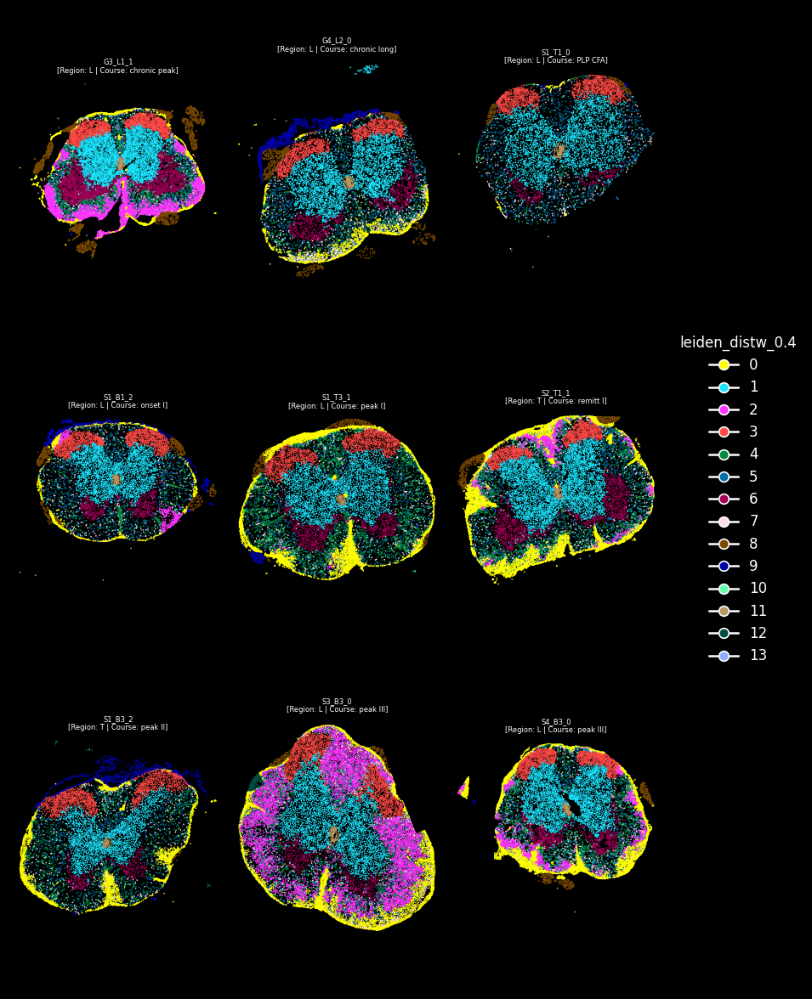

In [56]:
# usage
plot_spatial_compact_fast(
    ad,
    color="leiden_distw_0.4",
    groupby="sample_id",
    spot_size=1,
    cols=3,
    height=10,
    legend_col_width=1.0,
    background="black",
    grey_alpha=0.05,
    #highlight=['4','5']
)

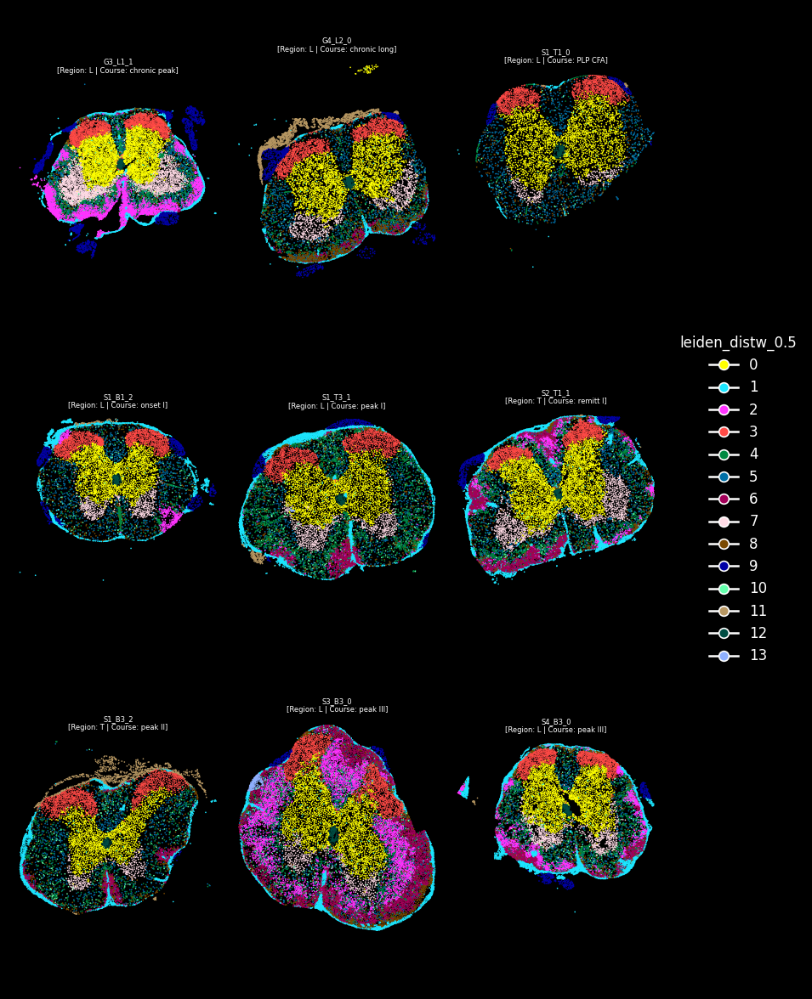

In [60]:
# usage
plot_spatial_compact_fast(
    ad,
    color="leiden_distw_0.5",
    groupby="sample_id",
    spot_size=1,
    cols=3,
    height=10,
    legend_col_width=1.0,
    background="black",
    grey_alpha=0.05,
    #highlight=['4','5']
)

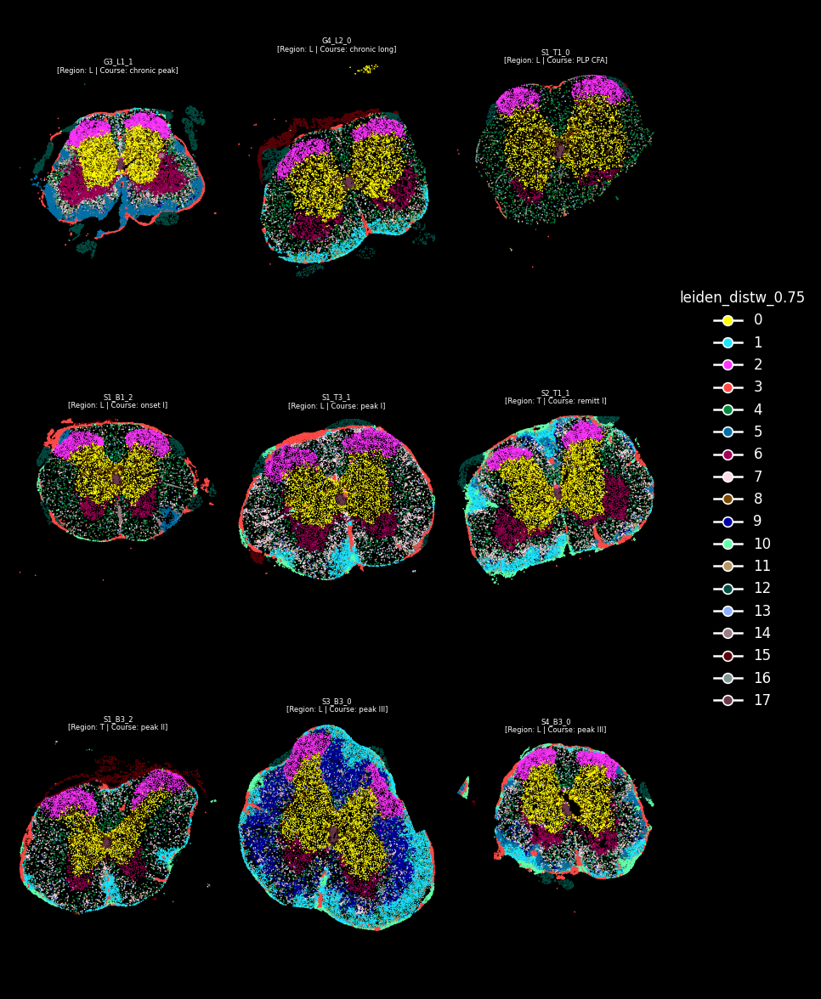

In [61]:
# usage
plot_spatial_compact_fast(
    ad,
    color="leiden_distw_0.75",
    groupby="sample_id",
    spot_size=1,
    cols=3,
    height=10,
    legend_col_width=1.0,
    background="black",
    grey_alpha=0.05,
    #highlight=['4','5']
)

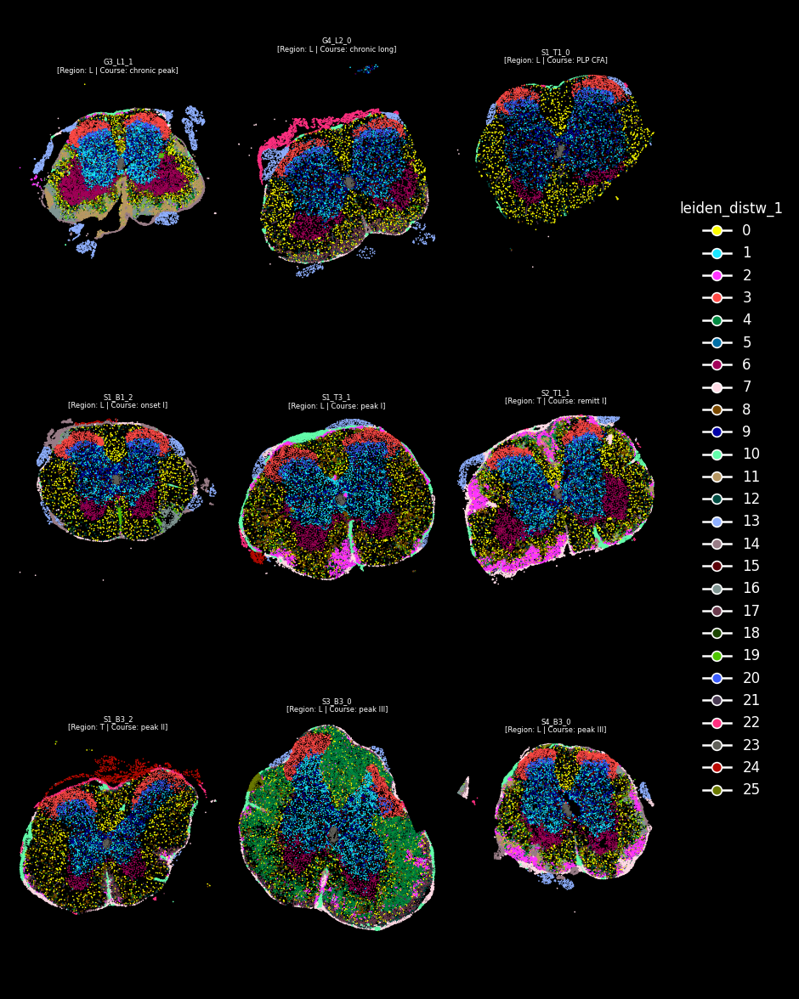

In [62]:
# usage
plot_spatial_compact_fast(
    ad,
    color="leiden_distw_1",
    groupby="sample_id",
    spot_size=1,
    cols=3,
    height=10,
    legend_col_width=1.0,
    background="black",
    grey_alpha=0.05,
    #highlight=['4','5']
)

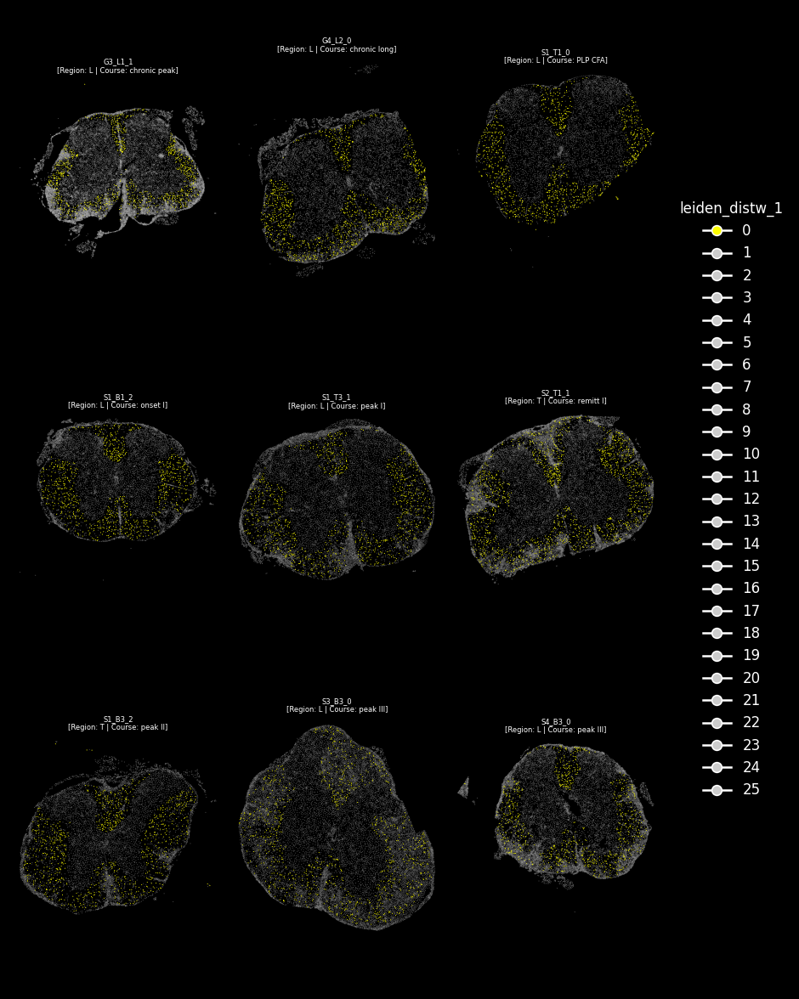

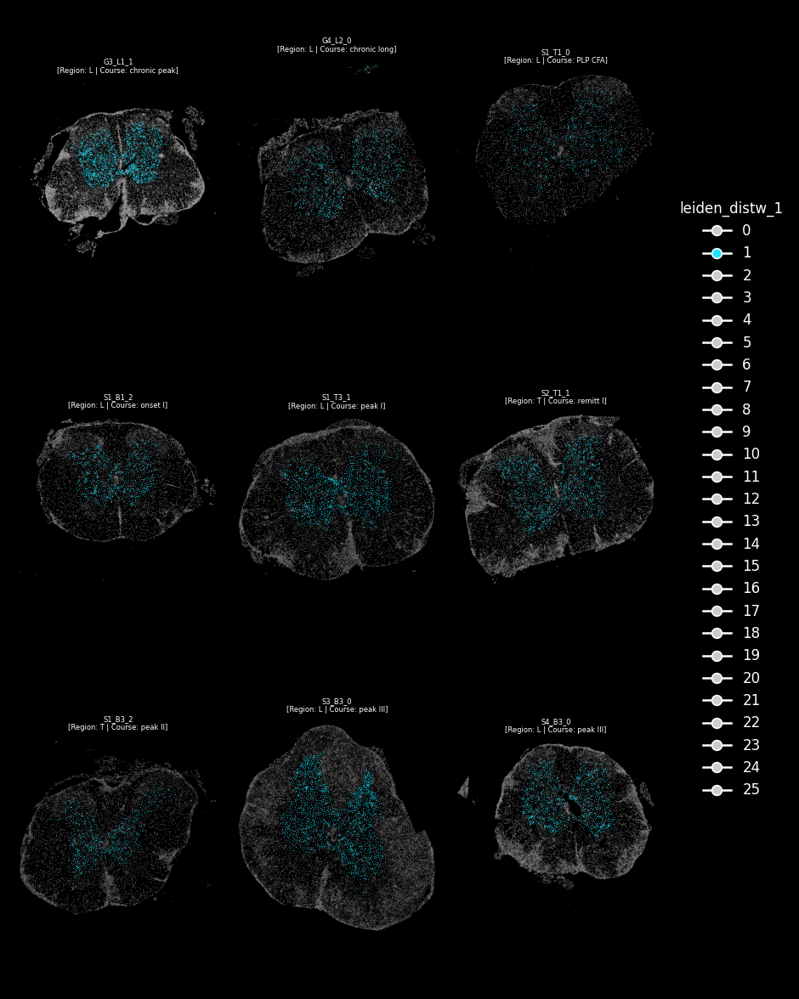

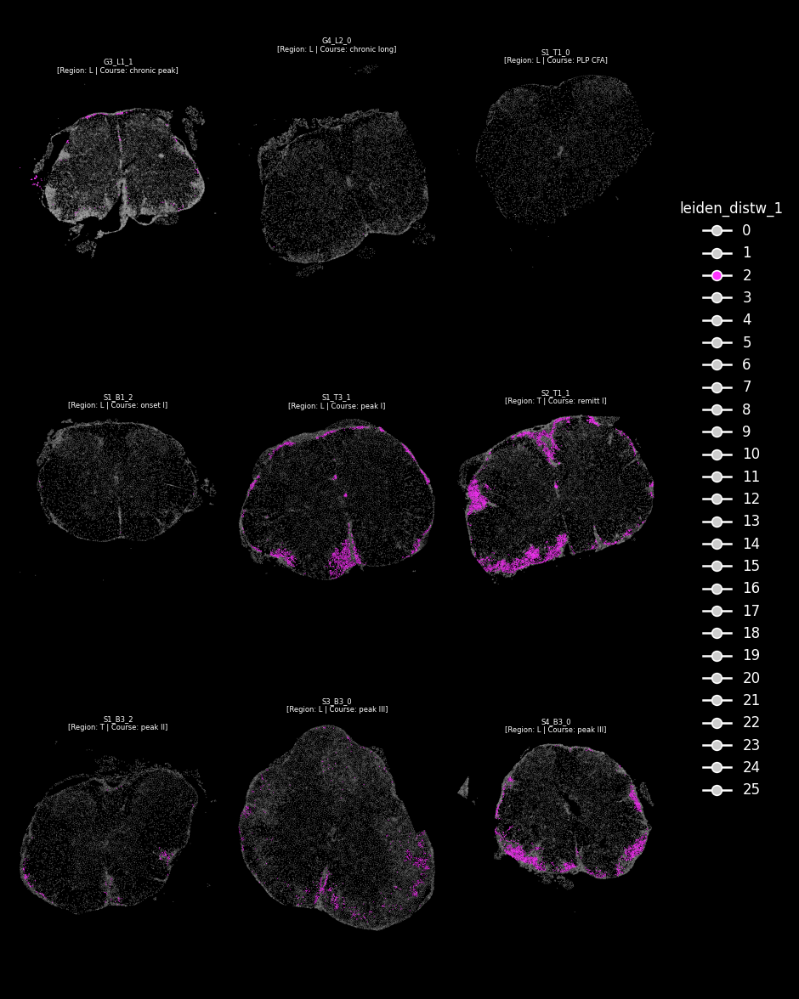

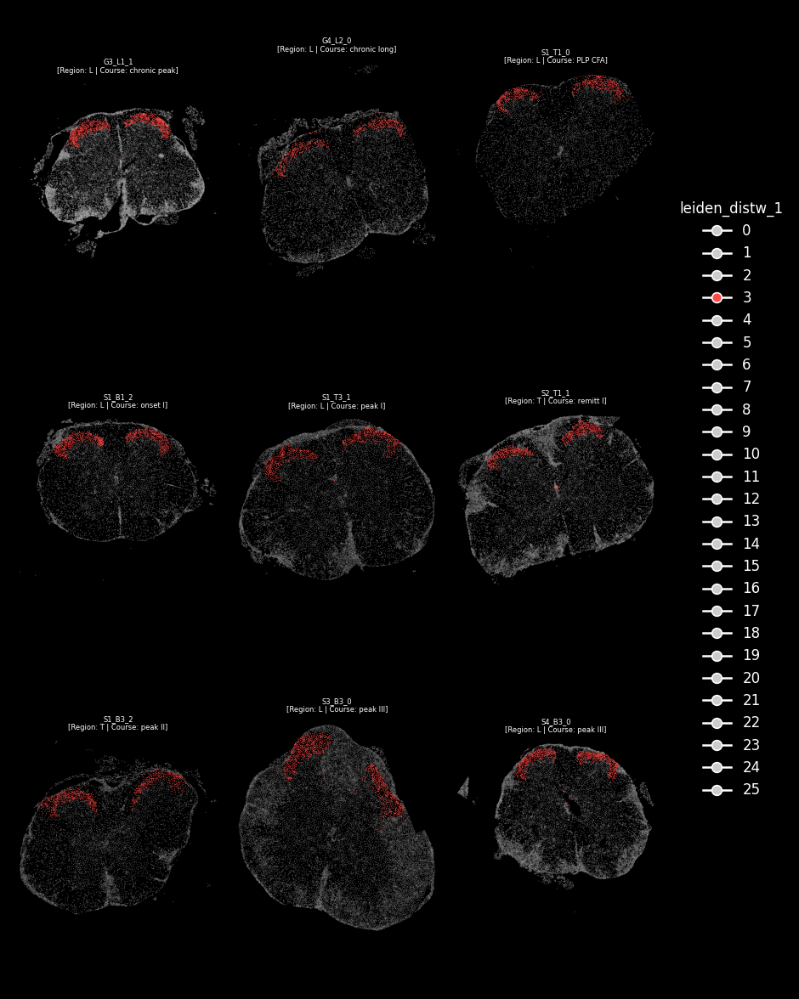

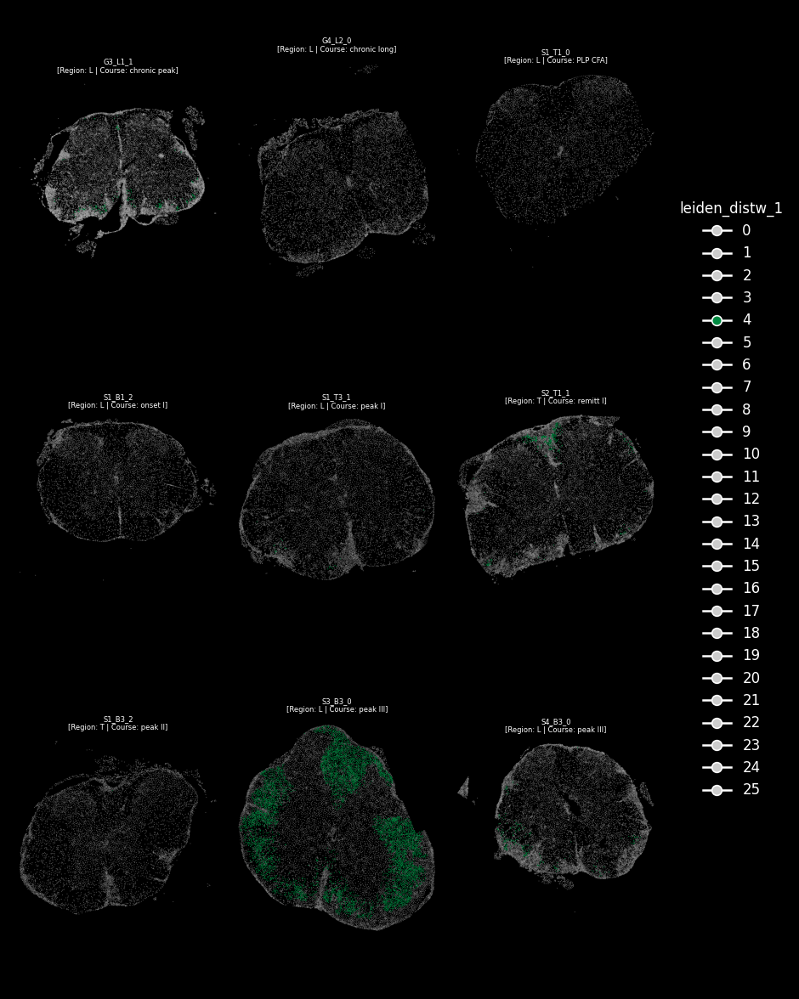

...

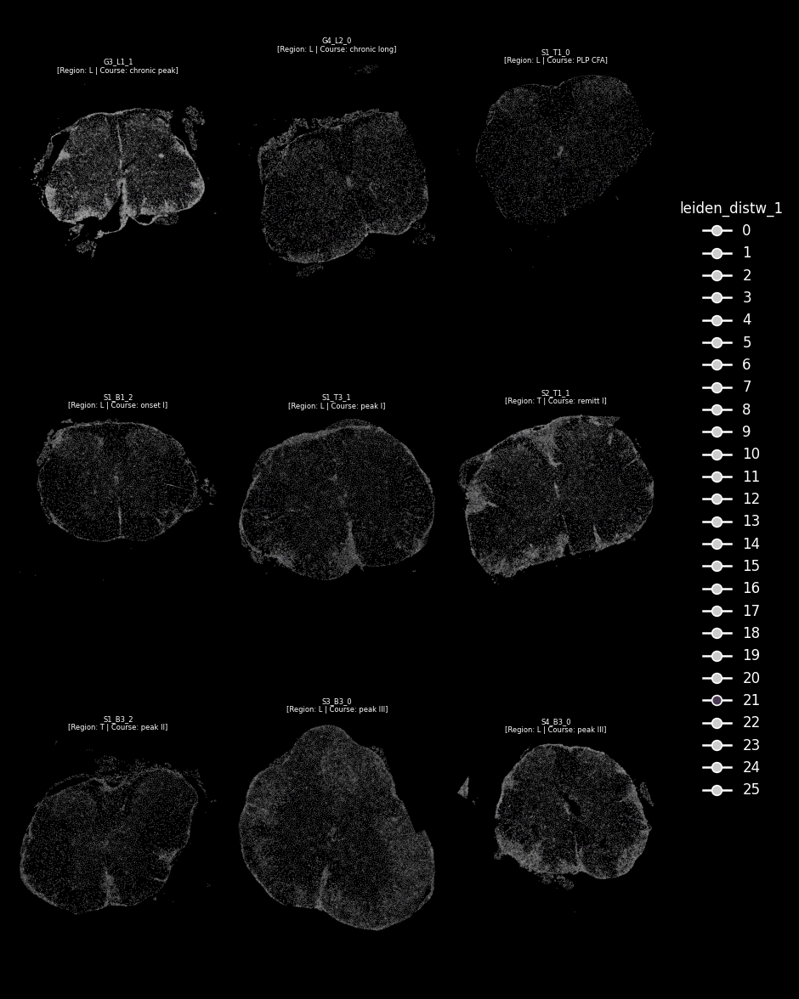

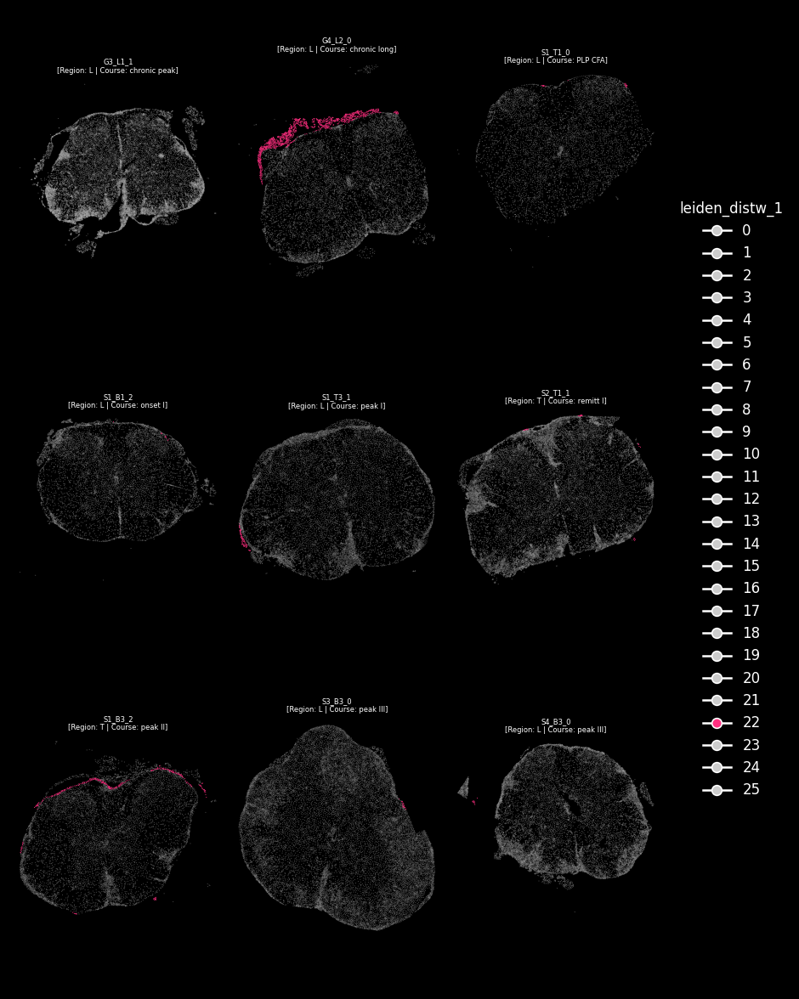

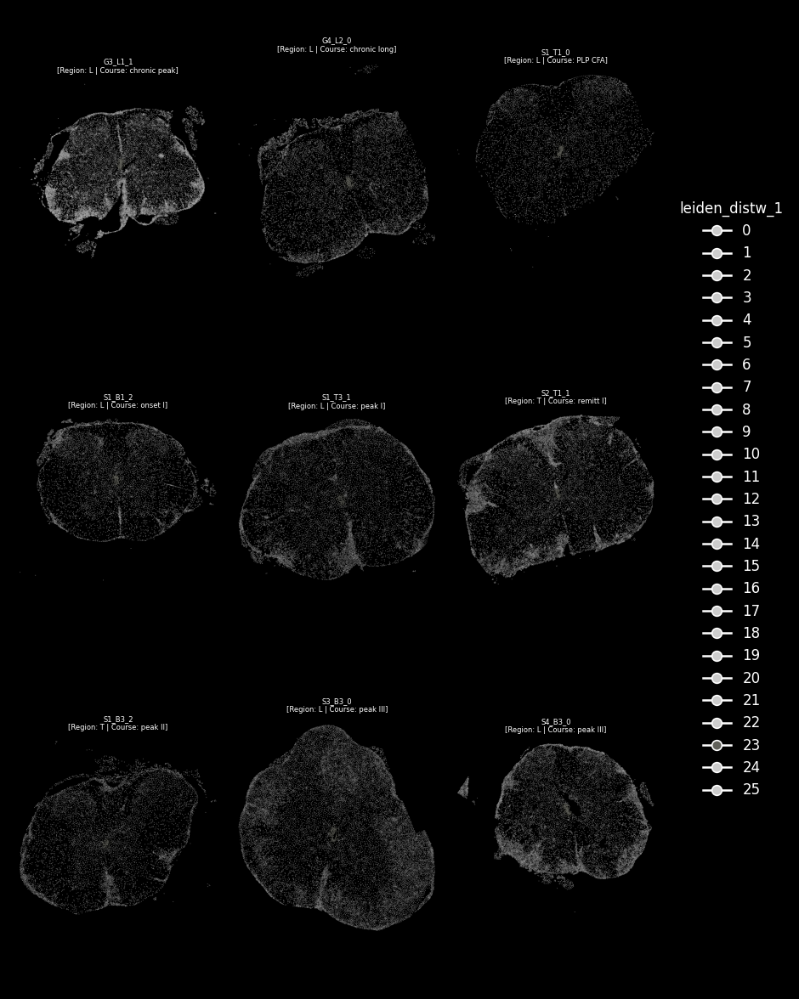

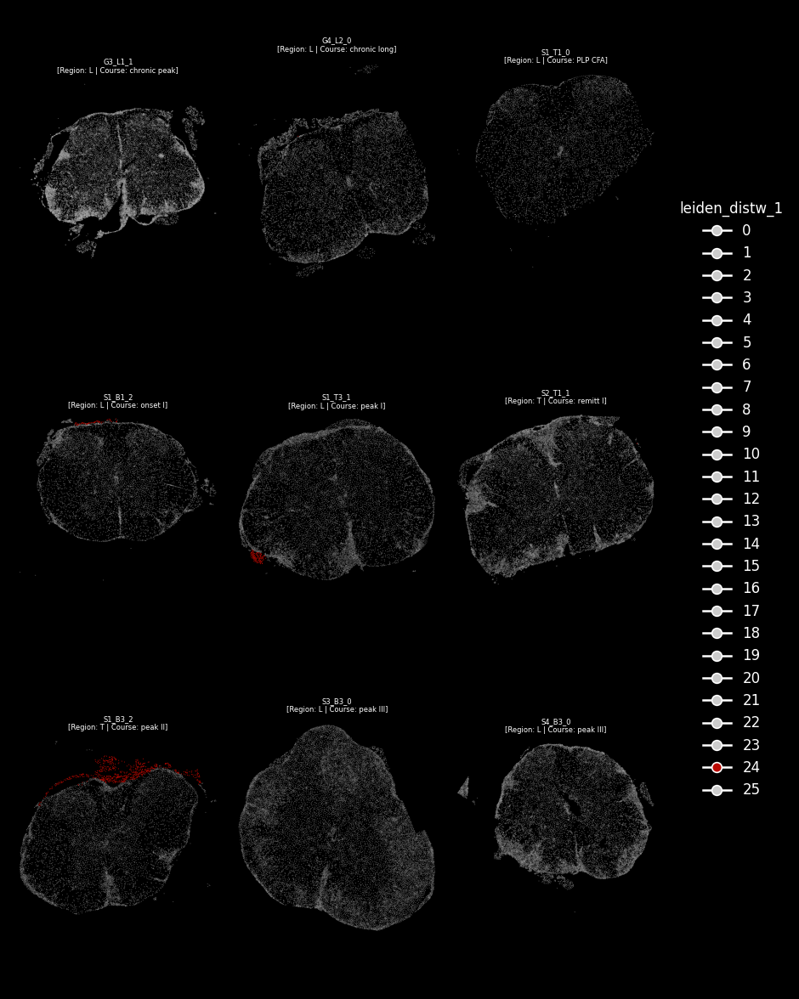

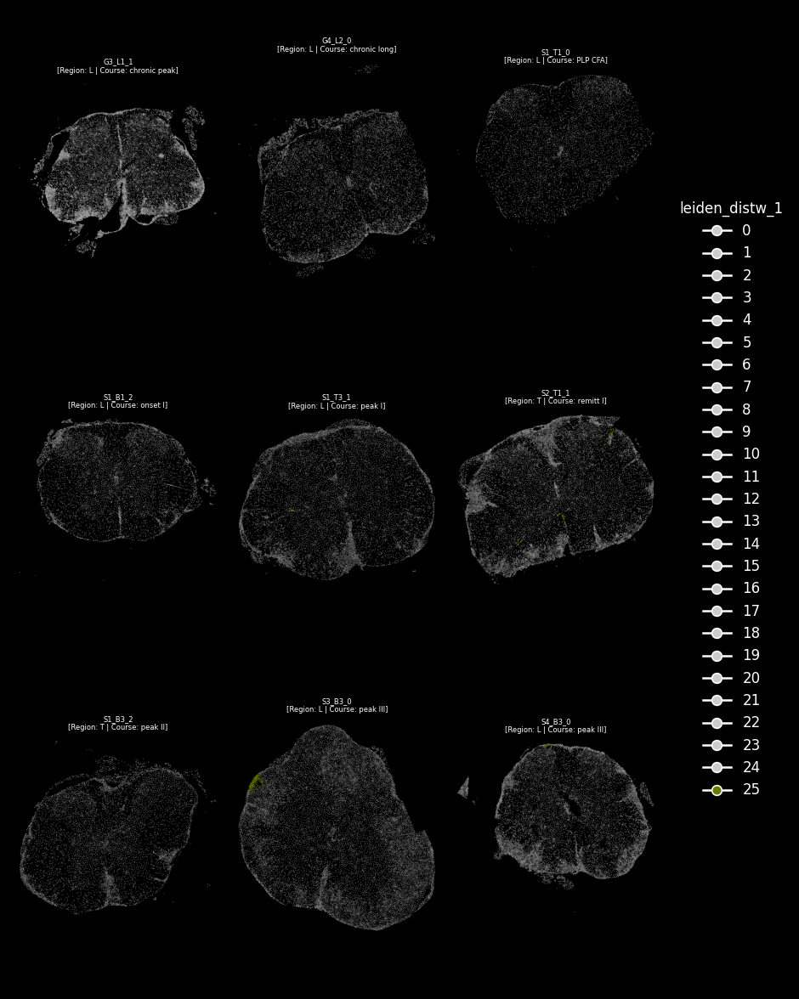

In [63]:
ad.obs['leiden_distw_1'] = ad.obs['leiden_distw_1'].astype('category')
for cluster in ad.obs['leiden_distw_1'].cat.categories:
    # usage
    plot_spatial_compact_fast(
        ad,
        color="leiden_distw_1",
        groupby="sample_id",
        spot_size=0.4,
        cols=3,
        height=10,
        legend_col_width=1.0,
        background="black",
        grey_alpha=0.4,
        highlight=[cluster]
    )

In [ ]:
# --- Find marker genes per cluster ---
sc.tl.rank_genes_groups(ad, groupby="leiden_distw_1", method="t-test")
sc.pl.rank_genes_groups(ad, n_genes=25, sharey=False)

# get a tidy table of top markers
markers = sc.get.rank_genes_groups_df(ad, group=None)
markers.head()
marker_genes = pd.DataFrame({
    group: ad.uns['rank_genes_groups']['names'][group][:30]
    for group in ad.uns['rank_genes_groups']['names'].dtype.names
})
for col in marker_genes.columns: 
    print(col)
    genes = marker_genes[col].tolist()
    print(" ".join(genes))
    print(' ')

In [33]:
lesion_compartments = ['1','3','4','6','9','12','13','18','22']
gm_compartments = ['2','5','7','8','10','15','17']
wm_compartments = ['0','11']
other = ['14','16','19','20','21']

## grey matter

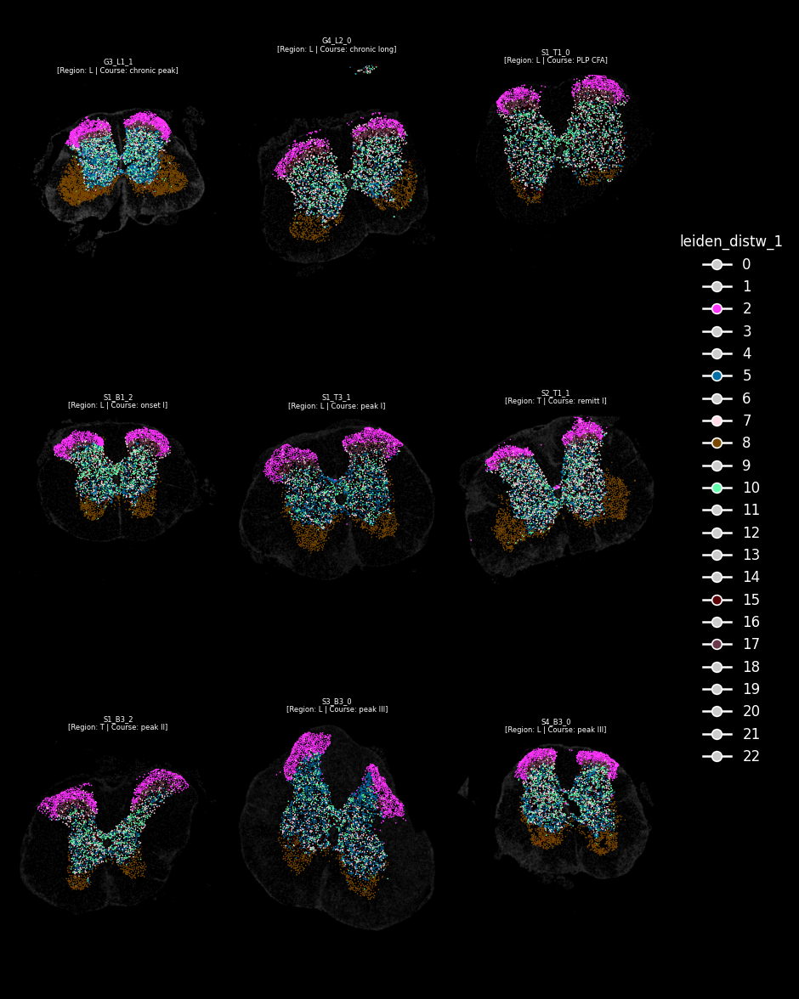

In [34]:
# usage

plot_spatial_compact_fast(
    ad,
    color="leiden_distw_1",
    groupby="sample_id",
    spot_size=1,
    cols=3,
    height=10,
    legend_col_width=1.0,
    background="black",
    grey_alpha=0.05,
    highlight=gm_compartments
)

## white matter

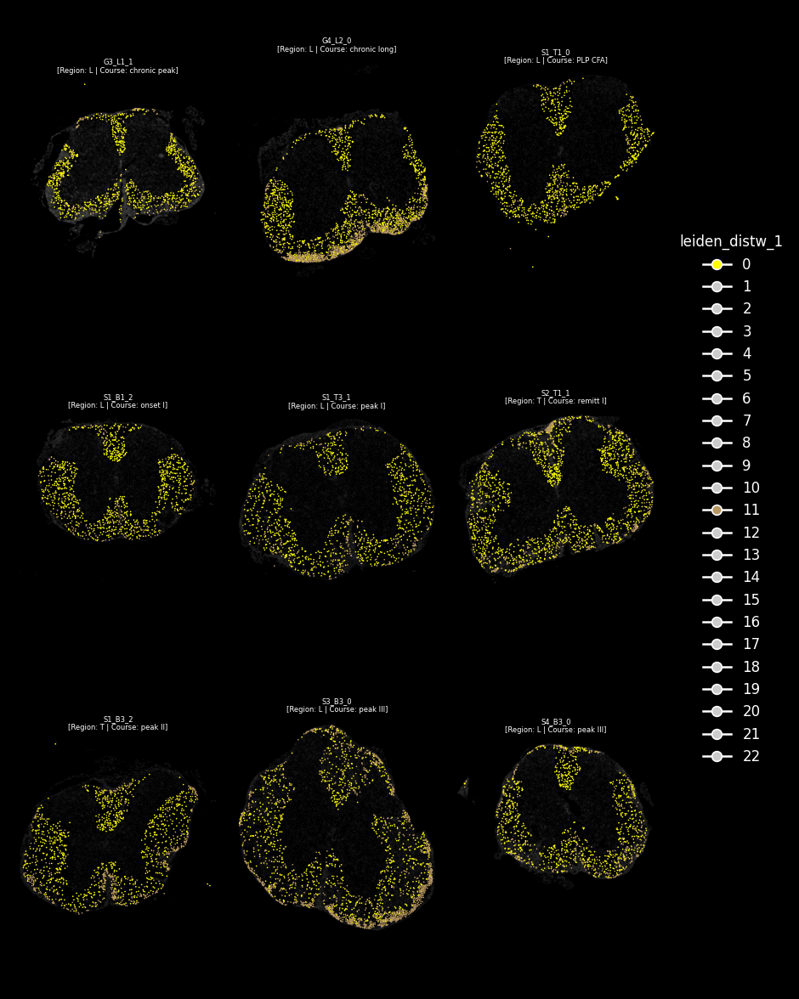

In [35]:
# usage

plot_spatial_compact_fast(
    ad,
    color="leiden_distw_1",
    groupby="sample_id",
    spot_size=1,
    cols=3,
    height=10,
    legend_col_width=1.0,
    background="black",
    grey_alpha=0.05,
    highlight=wm_compartments
)

## lesions

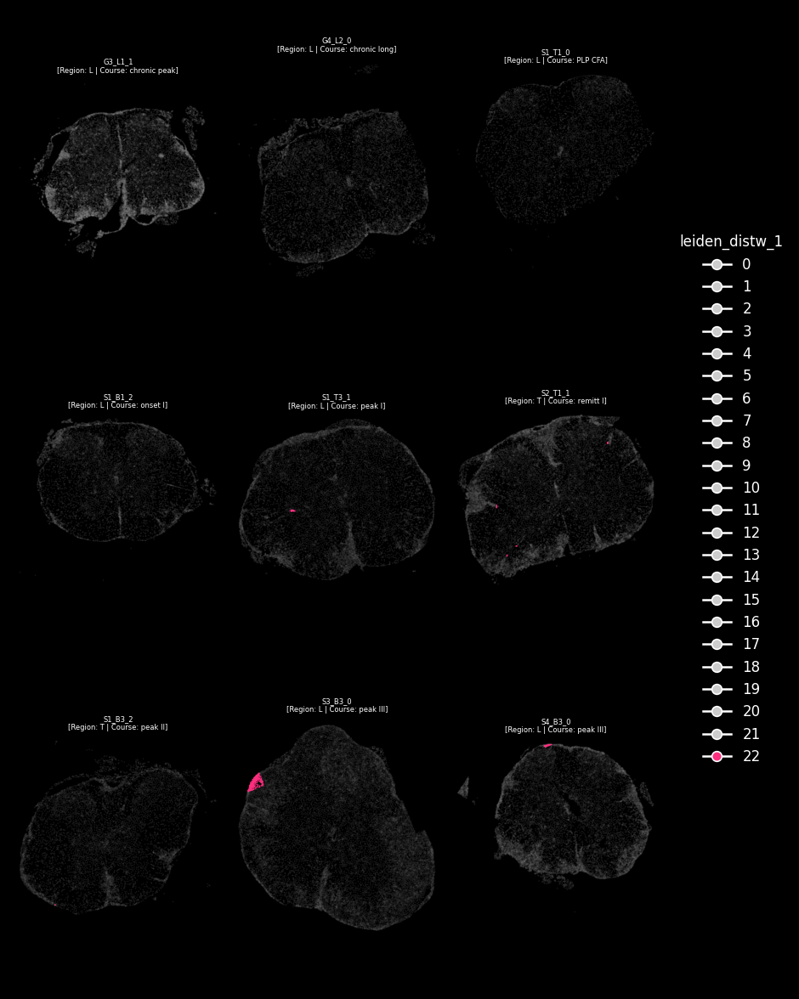

In [45]:
# usage

plot_spatial_compact_fast(
    ad,
    color="leiden_distw_1",
    groupby="sample_id",
    spot_size=1,
    cols=3,
    height=10,
    legend_col_width=1.0,
    background="black",
    grey_alpha=0.1,
    highlight=['22']
)

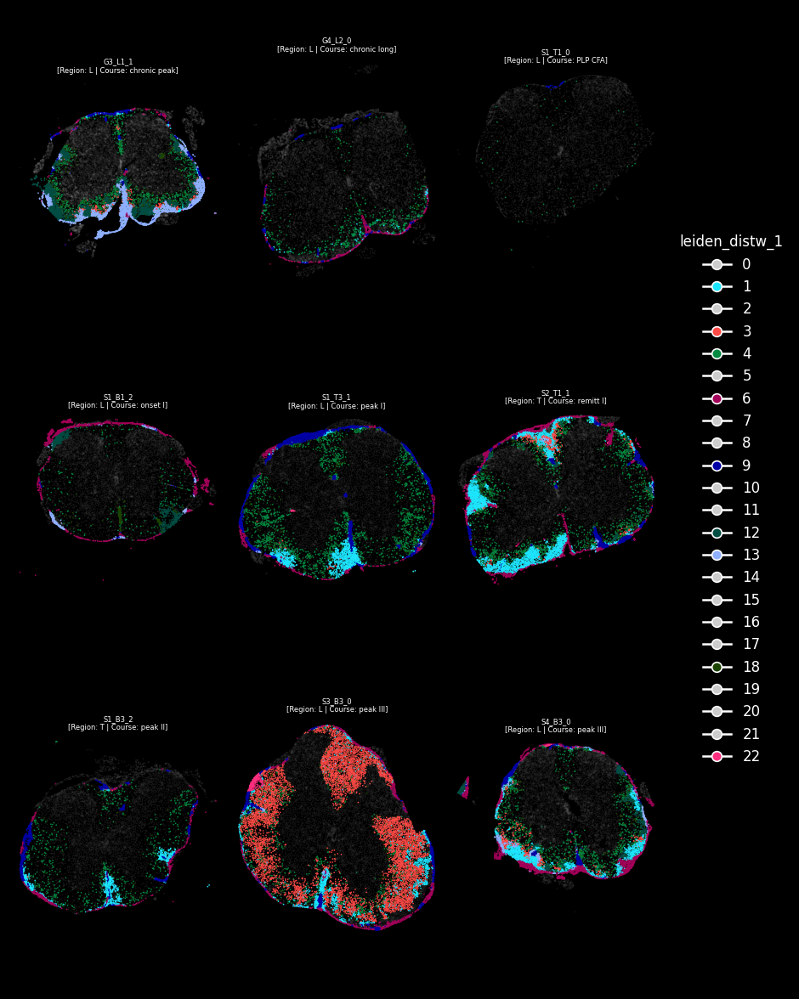

In [38]:
# usage

plot_spatial_compact_fast(
    ad,
    color="leiden_distw_1",
    groupby="sample_id",
    spot_size=1,
    cols=3,
    height=10,
    legend_col_width=1.0,
    background="black",
    grey_alpha=0.1,
    highlight=lesion_compartments
)

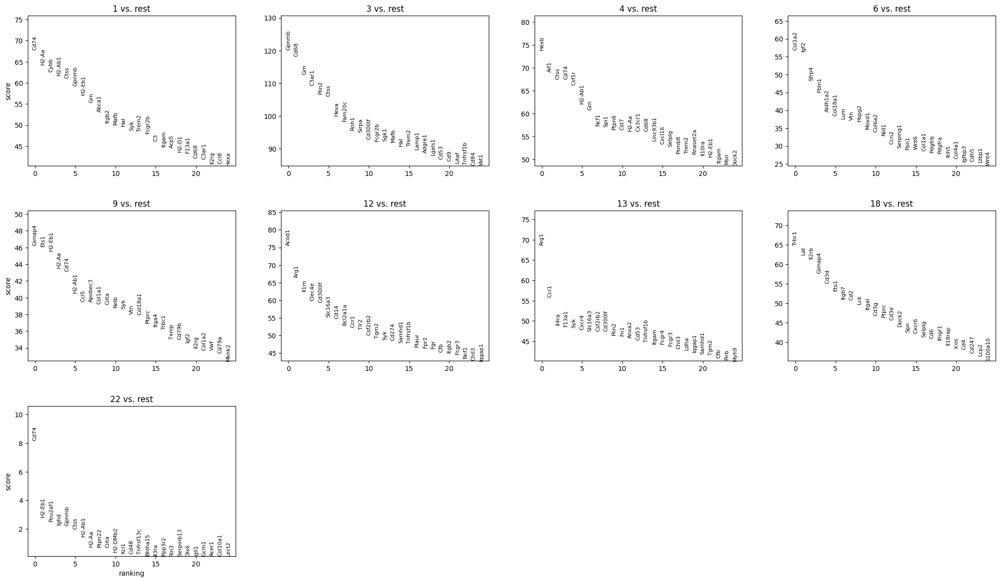

1
Cd74 H2-Aa Cybb H2-Ab1 Ctss Gpnmb H2-Eb1 Grn Abca1 Itgb2 Mafb Hal Syk Trem2 Fcgr2b C3 Itgam Acp5 H2-D1 F13a1 Cd68 C3ar1 Il2rg Ccl8 Hexa Tnfrsf1b Stab1 Mmp14 Sirpa Cd300lf
 
3
Gpnmb Cd68 Grn C3ar1 Plin2 Ctss Hexa Fam20c Rnh1 Sirpa Cd300lf Fcgr2b Sgk1 Mafb Hal Trem2 Lamp1 Adgre1 Lgals1 Cd53 Cd9 Litaf Tnfrsf1b Cd84 Vat1 Fn1 Sdcbp Itgb2 Plau Itgam
 
4
Hexb Aif1 Ctss Cd74 Csf1r H2-Ab1 Grn Ncf1 Spi1 Ptpn6 Cst7 H2-Aa Cx3cr1 Cd68 Unc93b1 Cxcl16 Selplg Psmb8 Trem2 Rnaset2a Il10ra H2-Eb1 Itgam Msn Dock2 Inpp5d B2m Mafb Fcgr3 Itgb2
 
6
Col1a2 Igf2 Sfrp4 Fbln1 Aldh1a2 Col18a1 Lum Vtn Hspg2 Moxd1 Col6a2 Nid1 Ccn2 Serping1 Fbn1 Wnt6 Col1a1 Pdgfrb Pdgfra Itih5 Col4a1 Igfbp3 Cdh5 Ltbp1 Wnt4 Nr2f2 Tgfbr3 Klf5 Cemip Cyp1b1
 
9
Gimap4 Ets1 H2-Eb1 H2-Aa Cd74 H2-Ab1 Ccl5 Apobec3 Col1a1 Ciita Relb Syk Vtn Col18a1 Ptprc Itga4 Trbc1 Txnip Cd79b Igf2 Il2rg Col1a2 Vwf Cd79a Mknk2 Birc3 Nfkb2 Dock2 Pltp Foxp1
 
12
Acod1 Arg1 Il1rn Clec4e Cd300lf Slc16a3 Cd14 Bcl2a1a Ccr1 Tlr2 Csf2rb2 Tgm2 Syk Cd274 Samhd1 Tnfr

In [37]:
import scanpy as sc

key = "leiden_distw_1"              # <-- change to your cluster column

sc.tl.rank_genes_groups(
    ad,
    groupby=key,
    groups=lesion_compartments,
    reference="rest",             # each group vs all other cells
    method="wilcoxon",
    pts=True,                     # add fraction expressing
)
sc.pl.rank_genes_groups(ad, n_genes=25, sharey=False)

marker_genes = pd.DataFrame({
    group: ad.uns['rank_genes_groups']['names'][group][:30]
    for group in ad.uns['rank_genes_groups']['names'].dtype.names
})
for col in marker_genes.columns: 
    print(col)
    genes = marker_genes[col].tolist()
    print(" ".join(genes))
    print(' ')

## lymphoid compartmetns

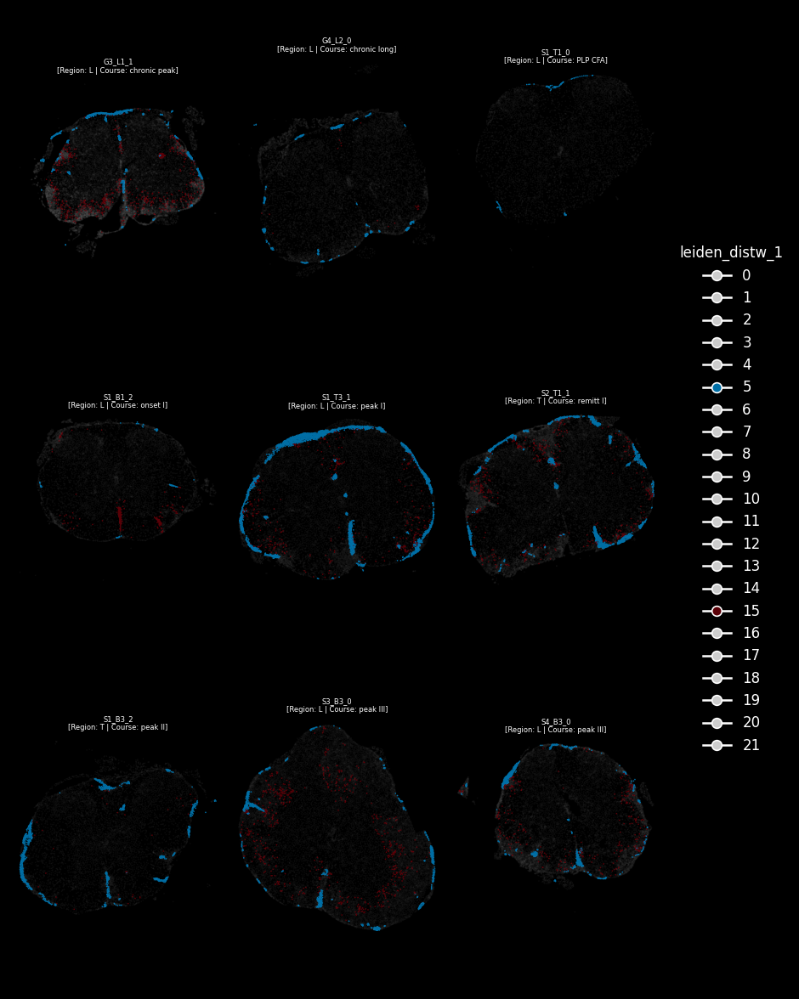

In [60]:
# usage
groups = ['5','15']          # <-- your three cluster labels (strings)

plot_spatial_compact_fast(
    ad,
    color="leiden_distw_1",
    groupby="sample_id",
    spot_size=1,
    cols=3,
    height=10,
    legend_col_width=1.0,
    background="black",
    grey_alpha=0.05,
    highlight=groups
)

In [68]:
import numpy as np
from sklearn.metrics import silhouette_score, davies_bouldin_score

key = "leiden_distw_0.4"          # your cluster labels
rep = "X_distweighted_ccstyle"    # or "X_mana_hd" or "X_scVI"

X = ad.obsm[rep]
y = ad.obs[key].astype(str).to_numpy()

sil = silhouette_score(X, y, metric="euclidean")
db  = davies_bouldin_score(X, y)

print("silhouette:", sil)
print("davies_bouldin:", db)

silhouette: 0.11696495115756989
davies_bouldin: 1.9266133200579936


In [ ]:
import numpy as np
from sklearn.metrics import silhouette_score, davies_bouldin_score

key = "leiden_distw_0.4"          # your cluster labels
rep = "X_distweighted_ccstyle"    # or "X_mana_hd" or "X_scVI"

X = ad.obsm[rep]
y = ad.obs[key].astype(str).to_numpy()

sil = silhouette_score(X, y, metric="euclidean")
db  = davies_bouldin_score(X, y)

print("silhouette:", sil)
print("davies_bouldin:", db)

In [23]:
ad.write('/Volumes/processing2/mana/mana.h5ad')